In [352]:
%load_ext autoreload
%autoreload 2
from dpe import DPE
from lib_data import *
import matplotlib.pyplot as plt
import numpy as np
# from lib_nn_dpe import NN_dpe
from IPython import display

import serial
%config InlineBackend.figure_formats = ['svg']



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [353]:
dpe = DPE('COM3')
dpe.set_clock(50)
# dpe.shape

DAC initialized to a span from -10 V to 10 V
Setting vrefs to default
Setting ADC_CK freq=50000.0kHz
Setting CK_ARRAY freq=50000.0kHz


## Read operation

Vread should be always between 0 and 0.45 (V)

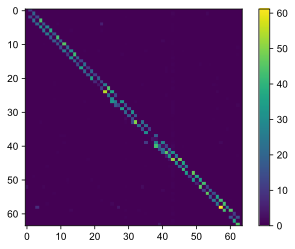

In [372]:
g = dpe.read(0, method='fast', Tdly=500, Vread=0.2)
plt.imshow(g * 1e6)
plt.colorbar()

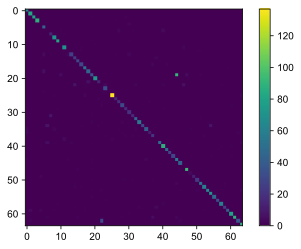

In [355]:
g = dpe.read(1, method='fast', Tdly=500, Vread=0.2)
plt.imshow(g *1e6)
plt.colorbar()

## Matrix multiplication

In [7]:
N = 100
vec_input = np.random.random((64, N))

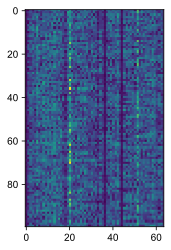

In [10]:
dpe.N_BIT = 8

vec_output = dpe.multiply(0, vec_input, c_sel=[0, 64], Vread=0.2, Tdly=500)

plt.imshow(vec_output)

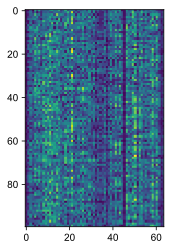

In [9]:
vec_output_soft = g @ vec_input
plt.imshow(vec_output_soft.T)

In [64]:
N = 100
vec_input = np.random.random((16, N))

vec_output = dpe.multiply(0, vec_input, c_sel=[0, 64], Vread=0.2, r_start=16, Tdly=500)

## Programming - Nominal matrix

In [341]:
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('schroedinger_superT_v1.mat')
# Scale the conductances by 4x to get better separation
G_neg = 4*mat_contents['G_neg']
G_pos = 4*mat_contents['G_pos']

arr = 0
Vgate = 5
Vref = 0.5
vRead = 0.2

targetTolerance = 4e-6

targetGNeg = np.zeros((64,64)) 
targetGNeg[0:64,0:64] = G_neg[0:64,0:64]

targetGPos = np.zeros((64,64))
targetGPos[0:64,0:64] = G_pos[0:64,0:64]

MselPos = np.zeros((64,64))
MselPos[np.nonzero(targetGPos)] = 1

MselNeg = np.zeros((64,64))
MselNeg[np.nonzero(targetGNeg)] = 1

In [175]:
# De-program positive array with absolute tolerance, and default settings for voltage ramps

dataChip39Arr0_GPos1 = dpe.tune_conductance(0, np.zeros((64,64)), saveHistory=True, maxSteps=50, maxRetry=2, method='fast', vSetRamp = [0.4, 2.6, 0.1], 
                                     vGateSetRamp = [0.3, 1.4, 0.05], vResetRamp = [0.3, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=1e-6, Gtol_out=2e-6, Msel=MselPos, numReads=3)

Start programming, step=48, maxBound=6 yield= 81.45% - 95.16%
1.0 devices to be programmed...reset 7.0, set 0.0
Setting 0 devices...
Programming with internal timing P_RESET=3
Resetting 1 devices...
Programming with external timing Twidth=1000.000 us
------------------------------
Programming completed.


In [281]:
# Program positive array with absolute tolerance, and default settings for voltage ramps

dataChip39Arr0_GPos1 = dpe.tune_conductance(0, targetGPos, saveHistory=True, maxSteps=100, maxRetry=3, method='fast', vSetRamp = [0.4, 2.6, 0.1], 
                                     vGateSetRamp = [0.3, 1.4, 0.05], vResetRamp = [0.3, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=10e-6, TwidthReset=1e-3, 
                                     Gtol_in=3e-6, Gtol_out=6e-6, Msel=MselPos, numReads=3)

Start programming, step=99, maxBound=1 yield= 1.61% - 2.42%
120.0 devices to be programmed...reset 3.0, set 118.0
Setting 118 devices...
Programming with external timing Twidth=10.000 us
Resetting 2 devices...
Programming with external timing Twidth=1000.000 us


In [32]:
# Program positive array with absolute tolerance and reduced step on SET voltage ramps

dataChip39Arr0_GPos1 = dpe.tune_conductance(0, targetGPos, saveHistory=True, maxSteps=100, maxRetry=2, method='fast', vSetRamp = [0.4, 2.6, 0.05], 
                                     vGateSetRamp = [0.3, 1.4, 0.01], vResetRamp = [0.3, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=2e-6, Gtol_out=5e-6, Msel=MselPos, numReads=3)

Start programming, step=99, maxBound=0 yield= 25.00% - 51.61%
77.0 devices to be programmed...reset 1.0, set 76.0
Setting 76 devices...
Programming with internal timing P_RESET=3
Resetting 1 devices...
Programming with external timing Twidth=1000.000 us


In [287]:
# Program positive array with relative tolerance and default settings for voltage ramps

dataChip39Arr0_GPos1 = dpe.tune_conductance(0, targetGPos, saveHistory=True, maxSteps=100, maxRetry=2, method='fast', vSetRamp = [0.4, 2.6, 0.1], 
                                     vGateSetRamp = [0.8, 1.4, 0.05], vResetRamp = [0.3, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=0.2, Gtol_out=0.25, Msel=MselPos, numReads=3,GtolType='rel')

Start programming, step=99, maxBound=1 yield= 37.10% - 43.55%
71.0 devices to be programmed...reset 3.0, set 69.0
Setting 69 devices...
Programming with internal timing P_RESET=3
Resetting 2 devices...
Programming with external timing Twidth=1000.000 us


In [333]:
# Program negative array with absolute tolerance and reduced step on SET voltage ramps
# BEST UNTILL NOW

dataChip39Arr1_GNeg1 = dpe.tune_conductance(1, targetGNeg, saveHistory=True, maxSteps=200, maxRetry=2, method='fast', vSetRamp = [1, 2, 0.5], 
                                     vGateSetRamp = [0.6, 1.4, 0.05], vResetRamp = [0.3, 2.6, 0.05], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=10e-6, TwidthReset=1e-3, 
                                     Gtol_in=2e-6, Gtol_out=5e-6, Msel=MselNeg, numReads=3)

Start programming, step=199, maxBound=18 yield= 39.06% - 64.06%
6.0 devices to be programmed...reset 5.0, set 19.0
Setting 1 devices...
Programming with external timing Twidth=10.000 us
Resetting 5 devices...
Programming with external timing Twidth=1000.000 us


In [ ]:
g = dpe.read(1, method='fast', Tdly=500, Vread=0.2)
plt.imshow(g *1e6)
plt.colorbar()

In [322]:
#CLEAR OUTER
Mselout=abs(MselPos-1)
dataChip39Arr0_GPos1 = dpe.tune_conductance(0, np.zeros((64,64)), saveHistory=True, maxSteps=50, maxRetry=2, method='fast', vSetRamp = [1, 2, 0.5], 
                                     vGateSetRamp = [0.8, 1.4, 0.05], vResetRamp = [0.3, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=1e-6, Gtol_out=20e-6, Msel=Mselout, numReads=3)

Start programming, step=49, maxBound=60 yield= 99.35% - 100.00%
-56.0 devices to be programmed...reset 4.0, set 0.0
Setting 0 devices...
Programming with internal timing P_RESET=3
Resetting 0 devices...
Programming with external timing Twidth=1000.000 us


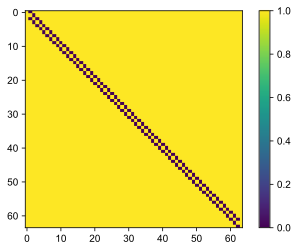

In [321]:
Mselout=abs(MselPos-1)
plt.imshow(Mselout)
plt.colorbar()

In [342]:
dataChip39Arr0_GPos1 = dpe.tune_conductance(0, targetGPos, saveHistory=True, maxSteps=200, maxRetry=3, method='fast', vSetRamp = [1.5, 3, 0.5], 
                                     vGateSetRamp =[0.6, 1.4, 0.05], vResetRamp = [0.3, 2.6, 0.05], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=10e-6, TwidthReset=1e-3, 
                                     Gtol_in=2e-6, Gtol_out=5e-6, Msel=MselPos, numReads=3)

Start programming, step=199, maxBound=12 yield= 33.87% - 57.26%
46.0 devices to be programmed...reset 15.0, set 43.0
Setting 31 devices...
Programming with external timing Twidth=10.000 us
Resetting 15 devices...
Programming with external timing Twidth=1000.000 us


..Saving In(<class 'list'>), Out(<class 'dict'>), g(<class 'numpy.ndarray'>), mat_contents(<class 'dict'>), G_neg(<class 'numpy.ndarray'>), G_pos(<class 'numpy.ndarray'>), arr(<class 'int'>), Vgate(<class 'int'>), Vref(<class 'float'>), vRead(<class 'float'>), targetTolerance(<class 'float'>), targetGNeg(<class 'numpy.ndarray'>), targetGPos(<class 'numpy.ndarray'>), MselPos(<class 'numpy.ndarray'>), MselNeg(<class 'numpy.ndarray'>), dataChip39Arr0_GPos1(<class 'dict'>), read(<class 'numpy.ndarray'>), SelEff(<class 'numpy.ndarray'>), ii(<class 'int'>), x(<class 'numpy.ndarray'>), xx(<class 'numpy.ndarray'>), yy(<class 'numpy.ndarray'>), TBE_RowCol(<class 'numpy.ndarray'>), TBE_Row(<class 'numpy.ndarray'>), TBE_Col(<class 'numpy.ndarray'>), Msel_derived(<class 'numpy.ndarray'>), SelEffPos(<class 'numpy.ndarray'>), Msel_derived_pos(<class 'numpy.ndarray'>), dataChip39Arr1_GNeg1(<class 'dict'>), SelEffNeg(<class 'numpy.ndarray'>), Msel_derived_neg(<class 'numpy.ndarray'>), A(<class 'numpy.

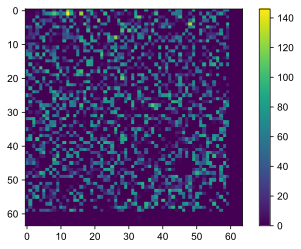

In [351]:
g = dpe.read(2, method='slow', Tdly=500, Vread=0.2)
plt.imshow(g *1e6)
plt.colorbar()
save_workspace(vars(), note='g_3_1_2020_P2')

In [55]:
x = 1;
np.isscalar(x)

True

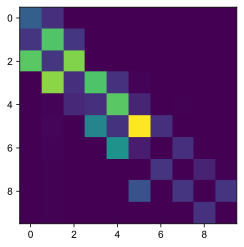

In [320]:
plt.imshow(g[45:55,45:55] *1e6)

In [33]:
from lib_tune_g import *

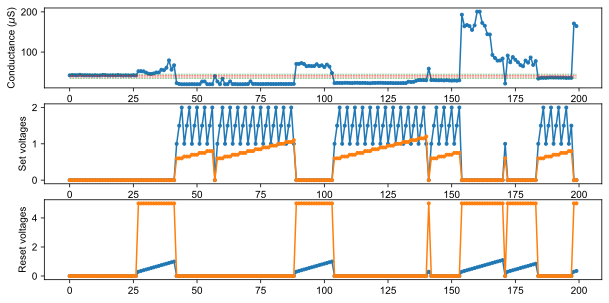

In [329]:
n=28
plot_history(n, n+1, dataChip39Arr0_GPos1)

In [ ]:
n=12
plot_history(n, n, dataChip39Arr0_GNeg1)

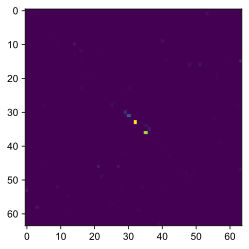

In [176]:
plt.imshow(dpe.read(0, method='fast'))


In [171]:
read=dpe.read(0, method='fast')

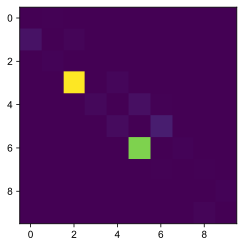

In [177]:
plt.imshow(read[30:40,30:40])

In [178]:
read[33,34]

2.7370478983382204e-06

In [82]:
from lib_tune_g import *
from IPython import display
from time import sleep

In [182]:
SelEff = get_working_subarray(dataChip39Arr0_GPos1);
SelEff = get_working_subarray(dataChip39Arr1_GNeg1); 

#print(np.array_equal(MselPos,SelEff))

#for jj in range(8):
#    print(MselPos[jj*8:(jj+1)*8,jj*8:(jj+1)*8])
#    print(SelEff[jj*8:(jj+1)*8,jj*8:(jj+1)*8])

print(np.where(SelEff == -1))

MselPos[np.array(SelEff,dtype=bool)].shape

Failures = np.where(SelEff == -1); 

#for ii in range(Failures[0].size):
#    plot_history(Failures[0][ii],Failures[1][ii],dataChip39Arr0_GPos1);
#    plot_history(Failures[0][ii],Failures[1][ii],dataChip39Arr1_GNeg1);
#    sleep(10);     
#    display.clear_output(wait=True);
    

(array([ 6,  7,  8,  9, 10, 11, 12, 16, 26, 27, 41, 50, 56, 57, 58, 59, 61,
       63], dtype=int64), array([ 6,  7,  8,  9, 10, 11, 12, 16, 26, 27, 41, 50, 56, 57, 58, 59, 61,
       63], dtype=int64))


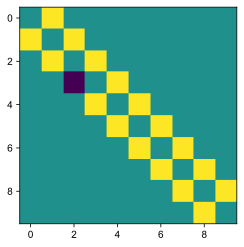

In [60]:
plt.imshow(SelEff[10:20,10:20])

## Crossbar-status-aware-remapping

1) Derive inactive rows and columns on both arrays.

POS Equivalent dimension: (57,58)


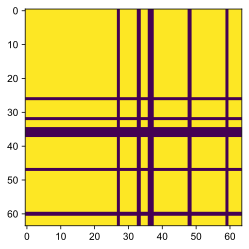

In [344]:
# Positive array
SelEffPos = get_working_subarray(dataChip39Arr0_GPos1);
FailuresPos = np.where(SelEffPos == -1);

TBE_Row_pos = np.unique(FailuresPos[0])
TBE_Col_pos = np.unique(FailuresPos[1])

Msel_derived_pos = np.ones(SelEff.shape)
Msel_derived_pos[TBE_Row_pos,:] = -1;
Msel_derived_pos[:,TBE_Col_pos] = -1;

plt.imshow(Msel_derived_pos)

print(f'POS Equivalent dimension: ({64-TBE_Row_pos.size},{64-TBE_Col_pos.size})'); 

NEG Equivalent dimension: (55,55)


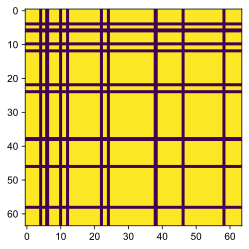

In [336]:
# Negative array
SelEffNeg = get_working_subarray(dataChip39Arr1_GNeg1);
FailuresNeg = np.where(SelEffNeg == -1);

TBE_Row_neg = np.unique(FailuresNeg[0])
TBE_Col_neg = np.unique(FailuresNeg[1])

Msel_derived_neg = np.ones(SelEff.shape)
Msel_derived_neg[TBE_Row_neg,:] = -1;
Msel_derived_neg[:,TBE_Col_neg] = -1;
 
plt.imshow(Msel_derived_neg)

print(f'NEG Equivalent dimension: ({64-TBE_Row_neg.size},{64-TBE_Col_neg.size})'); 

2) Generate a Schrodinger matrix adapted to the active region of the array

In [356]:
# Schrodinger matrix generation & eigenvector
N = np.min(64-np.hstack((TBE_Row_neg.size,TBE_Col_neg.size,TBE_Row_pos.size,TBE_Col_pos.size)));
N = 40;
print(f'Maximum allowable size: {N}'); 

B = np.diag(np.block([[0.5*np.ones((1,N-2),dtype=float),np.array([0],dtype=float)]]).reshape((N-1,)),-1); 
B = B + np.diag(np.block([[np.array([0],dtype=float),0.5*np.ones((1,N-2),dtype=float)]]).reshape((N-1,)),1);
B = B + np.diag(2*np.ones((1,N),dtype=float).reshape((N,))); 

for i in np.arange(0,N-1):
    for j in np.arange(0,N-1):
        if B[i,j] == 0:
            B[i,j] = 0.01;
        
# B is the conductance matrix, and the unit is 10 uS, which stands for 1.2208/0.16022 eV
B1 = 1.2208/0.16022*B; # 1 eV is regarded as 1  

C = np.diag(np.block([[1*np.ones((1,N-2),dtype=float),np.array([0],dtype=float)]]).reshape((N-1,)),-1);
C = C + np.diag(np.block([[np.array([0],dtype=float),1*np.ones((1,N-2),dtype=float)]]).reshape((N-1,)),1);
C = C + np.diag(1*np.ones((1,N),dtype=float).reshape((N,))); 

# 13,52 for N = 64 in matlab
width = 0.625*N;
idxlow = (N - width)/2;
idxhigh = idxlow + width;
for i in range(int(idxlow),int(idxhigh)):
    C[i,i] = C[i,i] + 0.6562; #% 5e-deep quantum well, 5*0.16022/1.2208 = 0.6562

for i in np.arange(0,N-1):
    for j in np.arange(0,N-1): 
        if C[i,j] == 0:
            C[i,j]=0.01;     
        
# C is the conductance matrix, and the unit is 10 uS, which stands for 1.2208/0.16022 eV
C1 = 1.2208/0.16022*C; #% 1 eV is regarded as 1 

A = B1 - C1; #% A is the energy matrix, the unit is eV.
A = -A;

lam,V = np.linalg.eig(A);

eig_idx = np.where(lam == np.max(lam))[0];

# Derive eigenvalue (threshold) and solution (eigenvector)
E_min = lam[eig_idx];
x_exact = V[:,eig_idx];
print(eig_idx);
print(E_min); 
print(x_exact);

Maximum allowable size: 40
[1]
[4.94845946]
[[0.00000000e+00]
 [6.23207773e-05]
 [2.05589361e-04]
 [6.15895814e-04]
 [1.82618290e-03]
 [5.40847984e-03]
 [1.60157947e-02]
 [4.74258577e-02]
 [7.81951756e-02]
 [1.07908041e-01]
 [1.36163019e-01]
 [1.62578371e-01]
 [1.86797216e-01]
 [2.08492344e-01]
 [2.27370644e-01]
 [2.43177063e-01]
 [2.55698047e-01]
 [2.64764434e-01]
 [2.70253731e-01]
 [2.72091776e-01]
 [2.70253736e-01]
 [2.64764443e-01]
 [2.55698062e-01]
 [2.43177081e-01]
 [2.27370667e-01]
 [2.08492370e-01]
 [1.86797246e-01]
 [1.62578405e-01]
 [1.36163055e-01]
 [1.07908079e-01]
 [7.81952154e-02]
 [4.74258986e-02]
 [1.60158362e-02]
 [5.40857574e-03]
 [1.82645778e-03]
 [6.16706739e-04]
 [2.07989627e-04]
 [6.94280646e-05]
 [2.10458895e-05]
 [0.00000000e+00]]


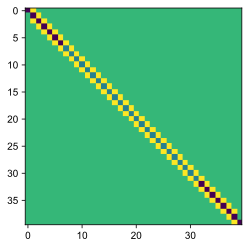

In [357]:
# Map Schrodinger's problem to conductances
V0 = 0.2;
Ie = 1e-6;
G = Ie/V0 * np.transpose(A); 

Gpos = np.zeros(G.shape); 
Gneg = np.zeros(G.shape); 

Gpos[G > 0] = G[G > 0];
Gneg[G < 0] = -G[G < 0];

plt.imshow(G);
#plt.imshow(Gpos);
#plt.imshow(Gneg);

(64, 64)


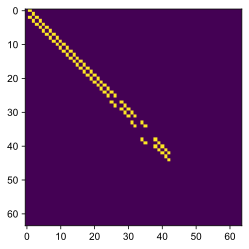

In [358]:
# Determine matrix to be programmed. Positive array
Cbsize = 64
TBP = np.copy(Gpos); 

# Disengage inactive rows
for ii in range(TBE_Row_pos.size):
    TBP = np.vstack([TBP[0:TBE_Row_pos[ii],:],np.zeros((1,TBP.shape[1])),TBP[TBE_Row_pos[ii]:,:]]); 

# Disengage inactive columns
for ii in range(TBE_Col_pos.size):
    TBP = np.hstack((TBP[:,0:TBE_Col_pos[ii]],np.zeros((TBP.shape[0],1)),TBP[:,TBE_Col_pos[ii]:])); 
    
# Pad rows and columns up to CBsize
TBP = np.hstack((TBP, np.zeros((TBP.shape[0],CBsize-TBP.shape[1]))));
TBP = np.vstack([TBP, np.zeros((CBsize-TBP.shape[0],TBP.shape[1]))]);

plt.imshow(Gpos);
plt.imshow(TBP);
print(TBP.shape)

TBP_Pos = np.copy(TBP); 

(64, 64)


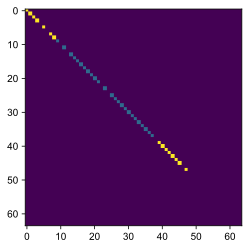

In [359]:
# Determine matrix to be programmed. Positive array
TBP = np.copy(Gneg); 

# Disengage inactive rows
for ii in range(TBE_Row_neg.size):
    TBP = np.vstack([TBP[0:TBE_Row_neg[ii],:],np.zeros((1,TBP.shape[1])),TBP[TBE_Row_neg[ii]:,:]]); 

# Disengage inactive columns
for ii in range(TBE_Col_neg.size):
    TBP = np.hstack((TBP[:,0:TBE_Col_neg[ii]],np.zeros((TBP.shape[0],1)),TBP[:,TBE_Col_neg[ii]:])); 
    
# Pad rows and columns up to CBsize
TBP = np.hstack((TBP, np.zeros((TBP.shape[0],CBsize-TBP.shape[1]))));
TBP = np.vstack([TBP, np.zeros((CBsize-TBP.shape[0],TBP.shape[1]))]);

plt.imshow(TBP);
print(TBP.shape)

TBP_Neg = np.copy(TBP); 

## Program array

* Reset cells programmed up to now.
* Attempt programming basing on new targets. 

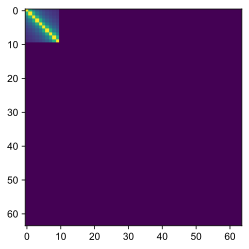

In [720]:
MselPos = np.zeros((64,64))
MselPos[np.nonzero(TBP_Pos)] = 1

MselNeg = np.zeros((64,64))
MselNeg[np.nonzero(TBP_Neg)] = 1

#TBP_Pos = 4*TBP_Pos; 
#TBP_Neg = 4*TBP_Neg; 
plt.imshow(TBP_Pos)

In [369]:
D=np.diag(np.ones(1,39),k=-1)
plt.imshow(D)

TypeError: data type not understood

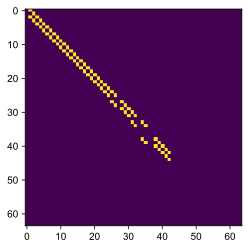

In [374]:
plt.imshow(MselPos)

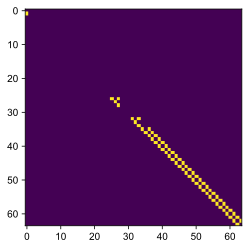

In [381]:
# To clear
Mclear=np.zeros((64,64))
for i in range(0,64):
    for j in range (0,64):
        if j==i-1 or j==i+1:
            Mclear[i,j]=1
Mclear=Mclear*abs(1-MselPos)
plt.imshow(Mclear)

In [382]:
# De-program positive array with absolute tolerance, and default settings for voltage ramps
Mres=abs(1-MselPos)
dataChip39Arr0_GPos1 = dpe.tune_conductance(0, np.zeros((64,64)), saveHistory=True, maxSteps=50, maxRetry=2, method='fast', vSetRamp = [0.4, 2.6, 0.1], 
                                     vGateSetRamp = [0.3, 1.4, 0.05], vResetRamp = [0.8, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=1e-6, Gtol_out=2e-6, Msel=Mclear, numReads=3)

Start programming, step=49, maxBound=3 yield= 89.39% - 92.42%
2.0 devices to be programmed...reset 5.0, set 0.0
Setting 0 devices...
Programming with internal timing P_RESET=3
Resetting 2 devices...
Programming with external timing Twidth=1000.000 us


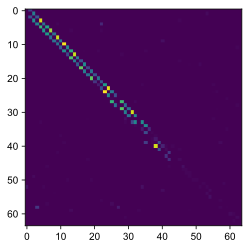

In [383]:
plt.imshow(dpe.read(0, method='fast'))

In [384]:
# Program positive array with absolute tolerance and reduced step on SET voltage ramps

dataChip39Arr0_GPos1 = dpe.tune_conductance(0, TBP_Pos, saveHistory=True, maxSteps=500, maxRetry=2, method='fast', vSetRamp = [1.5, 3, 0.1], 
                                     vGateSetRamp = [0.8, 1.4, 0.01], vResetRamp = [0.3, 2.6, 0.05], vGateResetRamp = [5.0, 5.5, 0.25], TwidthSet=20e-6, TwidthReset=10e-3, 
                                     Gtol_in=5e-6, Gtol_out=10e-6, Msel=MselPos, numReads=3)

Start programming, step=499, maxBound=0 yield= 67.11% - 92.11%
6.0 devices to be programmed...reset 0.0, set 6.0
Setting 6 devices...
Programming with external timing Twidth=20.000 us
Resetting 0 devices...
Programming with external timing Twidth=10000.000 us


In [407]:
# Reset all
Mclear=MselPos
Mclear=np.zeros((64,64))
Mclear[0,1]=1
dataChip39Arr0_GPos1 = dpe.tune_conductance(0, np.zeros((64,64)), saveHistory=True, maxSteps=10, maxRetry=2, method='fast', vSetRamp = [0.4, 2.6, 0.1], 
                                     vGateSetRamp = [0.3, 1.4, 0.05], vResetRamp = [0.8, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=1e-6, Gtol_out=2e-6, Msel=Mclear, numReads=3)

Start programming, step=9, maxBound=0 yield= 0.00% - 0.00%
1.0 devices to be programmed...reset 1.0, set 0.0
Setting 0 devices...
Programming with internal timing P_RESET=3
Resetting 1 devices...
Programming with external timing Twidth=1000.000 us


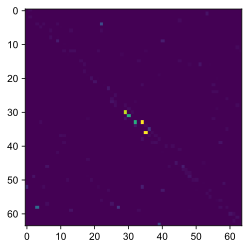

In [402]:
dataread=dpe.read(0, method='fast')
plt.imshow(dataread)

In [403]:
# Program Binary
dataChip39Arr0_GPos1 = dpe.tune_conductance(0, TBP_Pos, saveHistory=True, maxSteps=1, maxRetry=10, method='fast', vSetRamp = [2.8, 3, 0.1], 
                                     vGateSetRamp = [1.3, 1.4, 0.01], vResetRamp = [0.1, 0.2, 0.05], vGateResetRamp = [5.0, 5.5, 0.25], TwidthSet=20e-6, TwidthReset=10e-3, 
                                     Gtol_in=10e-6, Gtol_out=50e-6, Msel=MselPos, numReads=3)

Start programming, step=0, maxBound=0 yield= 3.95% - 100.00%
73.0 devices to be programmed...reset 0.0, set 73.0
Setting 73 devices...
Programming with external timing Twidth=20.000 us
Resetting 0 devices...
Programming with external timing Twidth=10000.000 us


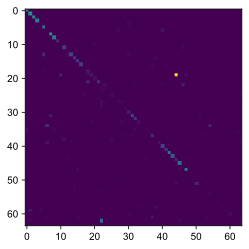

In [415]:
dataread=dpe.read(1, method='fast')
plt.imshow(dataread)

In [405]:
from scipy.io import savemat
savemat('polimi16032020_pos40binary.mat',{'data':dataread,'TBP_Pos':TBP_Pos,'TBP_Neg':TBP_Neg})

In [412]:
# Reset all
Mclear=np.eye(64)
dataChip39Arr1_GNeg1 = dpe.tune_conductance(1, np.zeros((64,64)), saveHistory=True, maxSteps=50, maxRetry=2, method='fast', vSetRamp = [0.4, 2.6, 0.1], 
                                     vGateSetRamp = [0.3, 1.4, 0.05], vResetRamp = [0.8, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=1e-6, Gtol_out=2e-6, Msel=Mclear, numReads=3)

Start programming, step=44, maxBound=1 yield= 84.38% - 98.44%
1.0 devices to be programmed...reset 2.0, set 0.0
Setting 0 devices...
Programming with internal timing P_RESET=3
Resetting 1 devices...
Programming with external timing Twidth=1000.000 us
------------------------------
Programming completed.


In [414]:
dataChip39Arr1_GNeg1 = dpe.tune_conductance(1, TBP_Neg, saveHistory=True, maxSteps=500, maxRetry=2, method='fast', vSetRamp = [1.5, 3, 0.1], 
                                     vGateSetRamp = [0.8, 1.4, 0.01], vResetRamp = [0.3, 2.6, 0.05], vGateResetRamp = [5.0, 5.5, 0.25], TwidthSet=20e-6, TwidthReset=10e-3, 
                                     Gtol_in=5e-6, Gtol_out=10e-6, Msel=MselNeg, numReads=3)

Start programming, step=499, maxBound=0 yield= 42.50% - 60.00%
17.0 devices to be programmed...reset 0.0, set 17.0
Setting 17 devices...
Programming with external timing Twidth=20.000 us
Resetting 0 devices...
Programming with external timing Twidth=10000.000 us


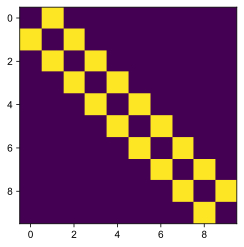

In [363]:
plt.imshow(TBP_Pos[10:20,10:20])


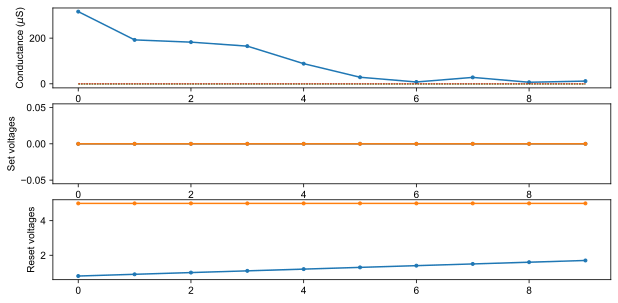

In [408]:
plot_history(0, 1, dataChip39Arr0_GPos1)

2000.0

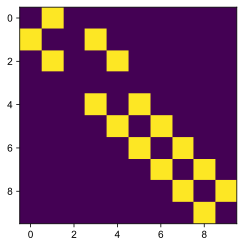

In [239]:
plt.imshow(TBP_Pos[10:20,10:20])
TBP_Pos[11,13]
1/500e-6
#plt.imshow(MselPos)

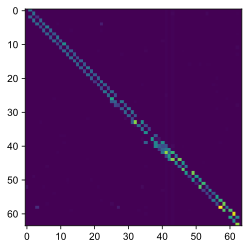

In [366]:
plt.imshow(dpe.read(0, method='fast'))

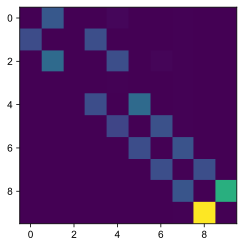

In [250]:
read = dpe.read(0,method='fast'); 
plt.imshow(read[10:20,10:20]);

In [260]:
# Program negative array with absolute tolerance and reduced step on SET voltage ramps

dataChip39Arr1_GNeg1 = dpe.tune_conductance(1, TBP_Neg, saveHistory=True, maxSteps=100, maxRetry=2, method='fast', vSetRamp = [1, 2.6, 0.05], 
                                     vGateSetRamp = [1, 1.4, 0.01], vResetRamp = [0.3, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=2e-6, Gtol_out=5e-6, Msel=MselNeg, numReads=3)

Start programming, step=99, maxBound=0 yield= 43.75% - 75.00%
15.0 devices to be programmed...reset 7.0, set 8.0
Setting 8 devices...
Programming with internal timing P_RESET=3
Resetting 7 devices...
Programming with external timing Twidth=1000.000 us


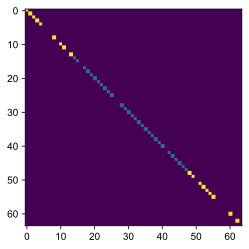

In [252]:
plt.imshow(TBP_Neg)

....

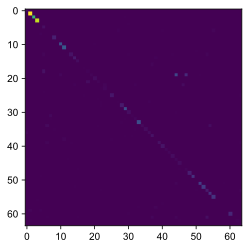

In [266]:
plt.imshow(dpe.read(1, method='slow'))

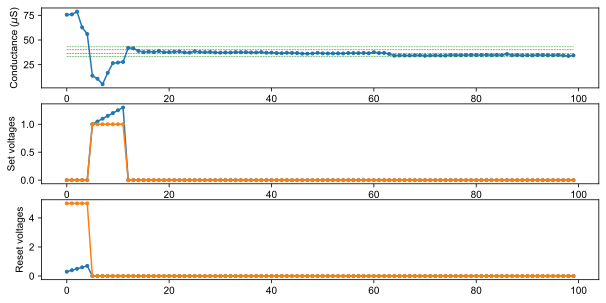

In [265]:
plot_history(52, 52, dataChip39Arr1_GNeg1)

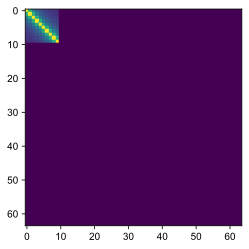

In [737]:
# TOEPLITZ 10x10
N=10
A=np.zeros([N,N])
for i in range(0,N):
    for j in range(0,N):
        A[i,j]=1/(np.abs(i-j)+1);
#plt.imshow(A)
Ie=1e-6
V0=0.2
alpha = 1.01;
threshold_min = np.max(-abs(np.linalg.eig(A)[0])**2 / (2*np.real(np.linalg.eig(A)[0]))); 
Ith = Ie * (threshold_min) * alpha; 
G = (V0**(-1) * (Ith * np.eye(N) + Ie * A))
G=G/np.max(np.max(G))
G=G/20e3
plt.imshow(G)
TBP_Pos=np.zeros([64,64])
TBP_Pos[0:10,0:10]=G
MselPos=np.zeros([64,64])
MselPos[0:10,0:10]=1
#plt.imshow(MselPos[30:40,30:40])
plt.imshow(TBP_Pos*MselPos)
#print(MselPos[30:40,30:40])

In [738]:
dataChip39Arr0_GPos1 = dpe.tune_conductance(0, TBP_Pos, saveHistory=True, maxSteps=500, maxRetry=2, method='fast', vSetRamp = [1.5, 3, 0.1], 
                                     vGateSetRamp = [0.7, 1.4, 0.01], vResetRamp = [0.3, 2.5, 0.05], vGateResetRamp = [5.0, 5.5, 0.25], TwidthSet=20e-6, TwidthReset=10e-3, 
                                     Gtol_in=3e-6, Gtol_out=8e-6, Msel=MselPos, numReads=3)

Start programming, step=197, maxBound=0 yield= 52.00% - 98.00%
3.0 devices to be programmed...reset 3.0, set 0.0
Setting 0 devices...
Programming with external timing Twidth=20.000 us
Resetting 3 devices...
Programming with external timing Twidth=10000.000 us
------------------------------
Programming completed.


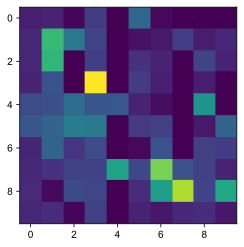

In [726]:
dataread=dpe.read(2, method='fast')
plt.imshow(dataread[30:40,30:40])
#plt.imshow(dataread)
#plt.clim(0,np.max(TBP_Pos))

In [739]:
# Fluctuation
import time
n_reads=100
r_vect=np.zeros([10*10,n_reads])
t_vect=np.zeros(n_reads)
t = time.time()
for n in range(0,n_reads):
    dataread=dpe.read(2, method='slow')
    r_vect[:,n]=np.reshape(dataread[0:10,0:10],[100,])
    t_vect[n]=time.time()-t

................................................................................................................................................................................................................................................................................................................................................................................................................

In [740]:
savemat('polimi30032020_pos10toeplitz_fluctuation_2_array_3.mat',{'G':r_vect,'t_vect':t_vect})

In [447]:
i=10
j=4
print(TBP_Pos[i,j],dataread[i,j])

5e-05 0.00015281850765721733


In [457]:
from scipy.io import savemat
savemat('polimi17032020_pos10toeplitz_2.mat',{'data':dataread,'TBP_Pos':TBP_Pos})

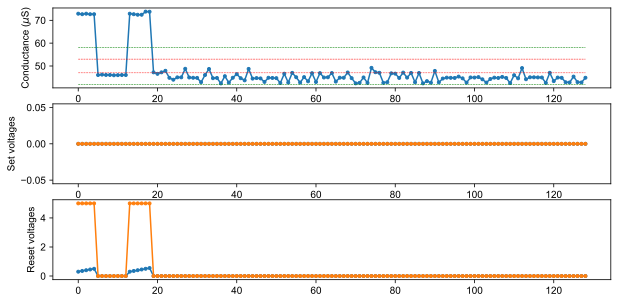

In [511]:
plot_history(9, 9, dataChip39Arr0_GPos1)

Start programming, step=31, maxBound=0 yield= 93.00% - 99.00%
1.0 devices to be programmed...reset 1.0, set 0.0
Setting 0 devices...
Programming with internal timing P_RESET=3
Resetting 1 devices...
Programming with external timing Twidth=1000.000 us
------------------------------
Programming completed.


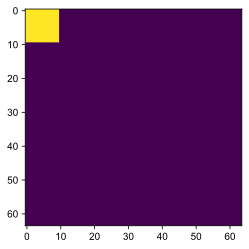

In [437]:
# Reset all
Mclear=np.zeros([64,64])
Mclear[0:10,0:10]=1
plt.imshow(Mclear)
dataChip39Arr0_GPos1 = dpe.tune_conductance(0, np.zeros((64,64)), saveHistory=True, maxSteps=50, maxRetry=2, method='fast', vSetRamp = [0.4, 2.6, 0.1], 
                                     vGateSetRamp = [0.3, 1.4, 0.05], vResetRamp = [0.8, 2.6, 0.1], vGateResetRamp = [5.0, 5.5, 0.5], TwidthSet=40e-9, TwidthReset=1e-3, 
                                     Gtol_in=1e-6, Gtol_out=2e-6, Msel=Mclear, numReads=3)

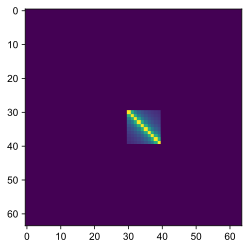

In [732]:
plt.imshow(TBP_Pos)

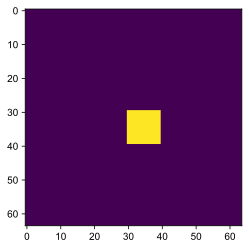

In [733]:
plt.imshow(MselPos)

In [734]:
dataChip39Arr0_GPos1 = dpe.tune_conductance(0, TBP_Pos, saveHistory=True, maxSteps=500, maxRetry=2, method='fast', vSetRamp = [1.5, 3, 0.1], 
                                     vGateSetRamp = [0.7, 1.4, 0.01], vResetRamp = [0.3, 2.5, 0.05], vGateResetRamp = [5.0, 5.5, 0.25], TwidthSet=20e-6, TwidthReset=10e-3, 
                                     Gtol_in=3e-6, Gtol_out=8e-6, Msel=MselPos, numReads=3)

Start programming, step=499, maxBound=0 yield= 8.00% - 26.00%
74.0 devices to be programmed...reset 10.0, set 64.0
Setting 64 devices...
Programming with external timing Twidth=20.000 us
Resetting 10 devices...
Programming with external timing Twidth=10000.000 us


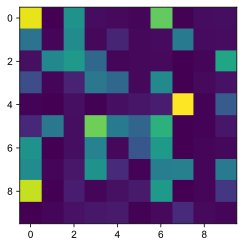

In [736]:
dataread=dpe.read(0, method='fast')
plt.imshow(dataread[0:10,0:10])

In [693]:
Gmeas=dataread[0:10,0:10]
V0 = 0.3
Ie = 1e-6
N = 10
Ith = 2*np.max(abs(np.linalg.eig(Gmeas*V0)[0]))
A = -Gmeas.transpose()*V0/Ie + Ith/Ie * np.eye(N)

In [694]:
b = np.ones([N,1])*5
b = np.random.randint(10, size=[N,1])*5
x_exact = np.dot(np.linalg.inv(A),b)
NumCycles = 100
V_Error_temp = np.empty(NumCycles)
V_Error_temp[:] = np.nan
input_vect = np.ones([N,NumCycles])*Ie*b
currents = np.zeros([N,NumCycles])
output_vect = np.zeros([N,NumCycles])
integration = np.zeros([N,NumCycles])
t_vect=np.zeros(n_reads)


In [695]:
dataread=dpe.read(0, method='fast')
tt = time.time()
for t in range(0,NumCycles):
    #currents[:,t]=np.dot(Gmeas.transpose(),output_vect[:,t])
    currents[:,t]=dpe.multiply(3, np.reshape(output_vect[:,t],[10,1]), c_sel=[0,10], mode=0, Vread=0.1)
    t_vect[t]=time.time()-tt
    if t > 0:
        integration[:,t]=integration[:,t-1]+currents[:,t]+input_vect[:,t]
    else:
        integration[:,t]=currents[:,t]+input_vect[:,t]
    if t < NumCycles-1:
        output_vect[:,t+1]=integration[:,t]/Ith*V0
        integration[:,t]=0
    err = abs(x_exact-np.reshape(output_vect[:,t],[10,1]))
    V_Error_temp[t] = np.sqrt(np.dot(err.transpose(),err))
    if t > 1 and all(abs(output_vect[:,t] - output_vect[:,t-1]) < 1e-14):
        break 
dataread_final=dpe.read(0, method='fast')

In [614]:
dpe.multiply(0, np.reshape(output_vect[:,t],[10,1]), c_sel=[0,10], mode=0, Vread=0)

C:\microchip\harmony\v2_06\apps\A0_DUT\dpe.py:641: RuntimeWarning: divide by zero encountered in true_divide
  return func_recover(outputs_dpe_all) / Vread


array([[inf, inf, inf, inf, inf, inf, inf, inf, inf, inf]])

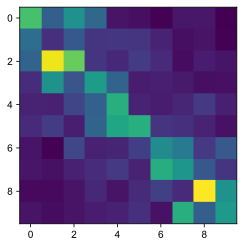

In [698]:
dataread_final=dpe.read(0, method='fast')
plt.imshow(dataread_final[0:10,0:10])

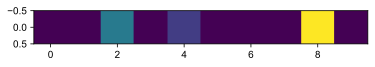

In [474]:
vec_input = 10*np.random.random((10, 1))
vec_input = np.reshape(output_vect[:,t],[10,1])
vec_output = dpe.multiply(0, vec_input, c_sel=[0, 10], Vread=0.2, Tdly=500)
plt.imshow(vec_output)

In [504]:
t

99

Text(0, 0.5, 'Measured solution')

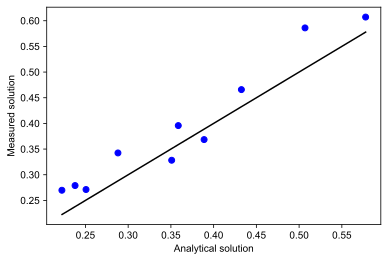

In [696]:
x_prime = output_vect[:,t]/V0
x_exact = np.dot(np.linalg.inv(A),b)
plt.plot(x_exact,x_prime,'bo')
plt.plot(x_exact,x_exact,'k')
plt.xlabel('Analytical solution')
plt.ylabel('Measured solution')

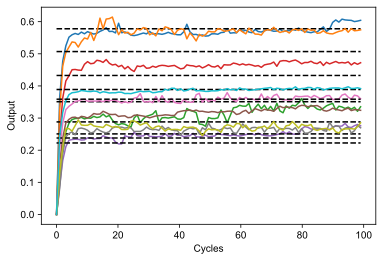

In [697]:
t_axis=np.linspace(0,t,t)
for d in range (0,N):
    plt.plot(t_axis,output_vect[d,0:t]/V0)
    plt.plot(t_axis,x_exact[d]*np.ones([t]),'--k')
    plt.xlabel('Cycles')
    plt.ylabel('Output')

Text(0, 0.5, 'Error')

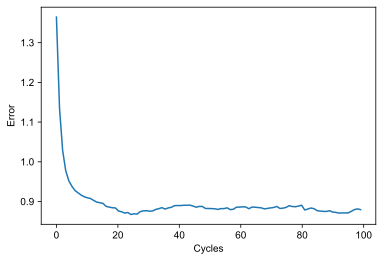

In [587]:
plt.plot(t_axis,V_Error_temp[0:t])
plt.xlabel('Cycles')
plt.ylabel('Error')

In [612]:
savemat('polimi24032020_10toeplitz_10.mat',{'Gmeas':dataread,'Gtarget':TBP_Pos, 'Gfinal':dataread_final,'currents': currents, 'input_vect': input_vect, 'output_vect': output_vect,'integration':integration,'V_Error_temp':V_Error_temp,'t_vect':t_vect})

# Reproduce the disturbe issue

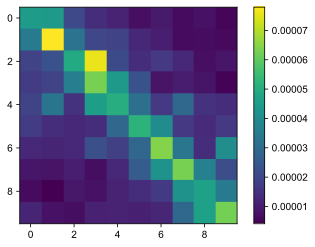

In [621]:
dataread=dpe.read(0, method='fast', Vread=0.2)
plt.imshow(dataread[0:10,0:10])
plt.colorbar()

g_prior = dataread

In [642]:
dataread=dpe.read(0, method='fast')
tt = time.time()
for t in range(0,NumCycles):
    if t %10 == 0:
        print('cycle =', t)
        
    #currents[:,t]=np.dot(Gmeas.transpose(),output_vect[:,t])
    currents[:,t]=dpe.multiply(0, np.reshape(output_vect[:,t],[10,1]), c_sel=[0,10], mode=0)
    
    t_vect[t]=time.time()-tt
    if t > 0:
        integration[:,t]=integration[:,t-1]+currents[:,t]+input_vect[:,t]
    else:
        integration[:,t]=currents[:,t]+input_vect[:,t]
    if t < NumCycles-1:
        output_vect[:,t+1]=integration[:,t]/Ith*V0
        integration[:,t]=0
    err = abs(x_exact-np.reshape(output_vect[:,t],[10,1]))
    V_Error_temp[t] = np.sqrt(np.dot(err.transpose(),err))
    if t > 1 and all(abs(output_vect[:,t] - output_vect[:,t-1]) < 1e-14):
        break 
dataread_final=dpe.read(0, method='fast')

cycle = 0
cycle = 10
cycle = 20
cycle = 30
cycle = 40
cycle = 50
cycle = 60
cycle = 70
cycle = 80
cycle = 90


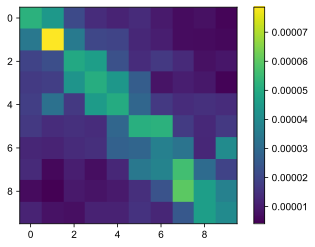

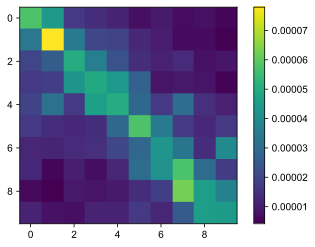

In [643]:
plt.figure(1)
plt.imshow(dataread[:10,:10])
plt.colorbar()

plt.figure(2)
plt.imshow(dataread_final[:10,:10])
plt.colorbar()

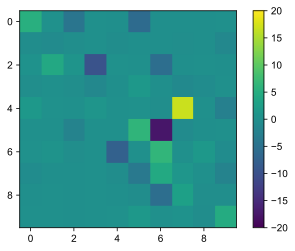

In [644]:
plt.imshow( (dataread_final[:10,:10] - dataread[:10,:10]) * 1e6, clim=[-20,20] )
plt.colorbar()

In [638]:
dataread=dpe.read(0, method='fast')
tt = time.time()
for t in range(0,NumCycles):
    if t %10 == 0:
        print('cycle =', t)
        
    #currents[:,t]=np.dot(Gmeas.transpose(),output_vect[:,t])
    currents[:,t]=dpe.multiply(0, np.reshape(output_vect[:,t],[10,1]), c_sel=[0,10], mode=0, Vread=0.05)
    
    t_vect[t]=time.time()-tt
    if t > 0:
        integration[:,t]=integration[:,t-1]+currents[:,t]+input_vect[:,t]
    else:
        integration[:,t]=currents[:,t]+input_vect[:,t]
    if t < NumCycles-1:
        output_vect[:,t+1]=integration[:,t]/Ith*V0
        integration[:,t]=0
    err = abs(x_exact-np.reshape(output_vect[:,t],[10,1]))
    V_Error_temp[t] = np.sqrt(np.dot(err.transpose(),err))
    if t > 1 and all(abs(output_vect[:,t] - output_vect[:,t-1]) < 1e-14):
        break 
dataread_final=dpe.read(0, method='fast')

cycle = 0
cycle = 10
cycle = 20
cycle = 30
cycle = 40
cycle = 50
cycle = 60
cycle = 70
cycle = 80
cycle = 90


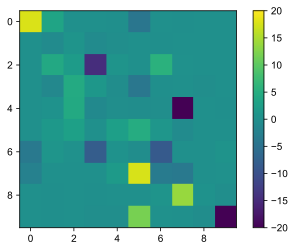

In [641]:
plt.imshow( (dataread_final[:10,:10] - dataread[:10,:10]) * 1e6, clim=[-20, 20])
plt.colorbar()

In [730]:
import time

g_all = []
for t in range(100):
    if t%10 == 0:
        print(t)
    
    g = dpe.read(2, method='fast')
    g_all.append(g[50:60,50:60])
    
    time.sleep(1)
    
    

0
10
20
30
40
50
60
70
80
90


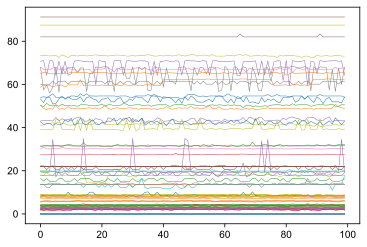

In [731]:
g_all = np.array(g_all)

for x in range(10):
    for y in range(10):
        plt.plot(np.arange(100), g_all[:,x,y] * 1e6, linewidth=0.5)

In [652]:
import time

g_all = []
for t in range(100):
    if t%10 == 0:
        print(t)
    
    g = dpe.read(0, method='fast', Tdly=5000)
    g_all.append(g[:10,:10])
    
#     time.sleep(1)
    

0
10
20
30
40
50
60
70
80
90


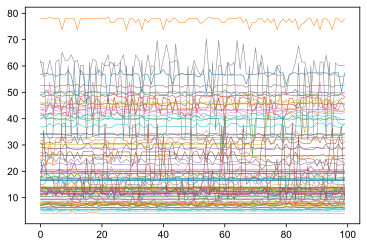

In [651]:
g_all = np.array(g_all)

for x in range(10):
    for y in range(10):
        plt.plot(np.arange(100), g_all[:,x,y] * 1e6, linewidth=0.5)

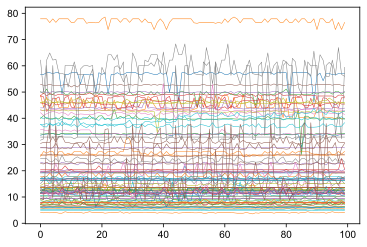

In [653]:
g_all = np.array(g_all)

for x in range(10):
    for y in range(10):
        plt.plot(np.arange(100), g_all[:,x,y] * 1e6, linewidth=0.5)

In [654]:
import time

g_all = []
for t in range(100):
    if t%10 == 0:
        print(t)
    
    g = dpe.read(0, method='slow')
    g_all.append(g[:10,:10])
    
#     time.sleep(1)


0
........................................10
........................................20
........................................30
........................................40
........................................50
........................................60
........................................70
........................................80
........................................90
........................................

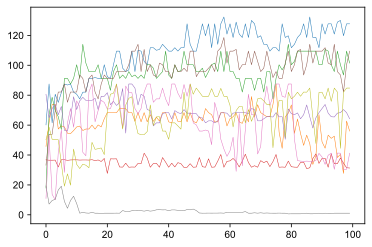

In [657]:
g_all = np.array(g_all)

for x in range(3):
    for y in range(3):
        plt.plot(np.arange(100), g_all[:,x,y] * 1e6, linewidth=0.5)

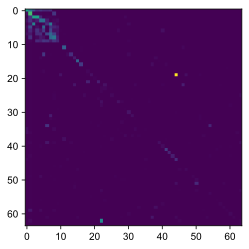

In [705]:
plt.imshow(dpe.read(1, method='fast'))

In [706]:
import time

g_all = []
for t in range(100):
    if t%10 == 0:
        print(t)
    
    g = dpe.read(1, method='fast', Tdly=1000)
    g_all.append(g[:10,:10])
    
#     time.sleep(1)
    

0
10
20
30
40
50
60
70
80
90


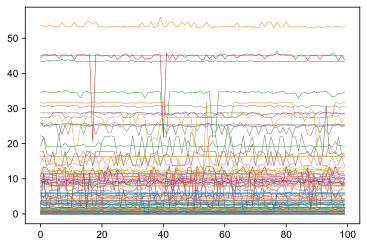

In [707]:
g_all = np.array(g_all)

for x in range(10):
    for y in range(10):
        plt.plot(np.arange(100), g_all[:,x,y] * 1e6, linewidth=0.5)

In [665]:
import time

g_all = []
for t in range(100):
    if t%10 == 0:
        print(t)
    
    g = dpe.read(1, method='fast', Tdly=1000)
    g_all.append(g[:60,:60])
    
#     time.sleep(1)
    

0
10
20
30
40
50
60
70
80
90


In [667]:
g_all = np.array(g_all)

for x in range(60):
    for y in range(60):
        plt.plot(np.arange(100), g_all[:,x,y] * 1e6, linewidth=0.5)

In [670]:
import time

g_all = []
for t in range(100):
    if t%10 == 0:
        print(t)
    
    g = dpe.read(0, method='fast', Tdly=1000)
    g_all.append(g)
    
    time.sleep(1)

0
[ERROR] SPI return wrong value
[ERROR] SPI return wrong value
[ERROR] SPI return wrong value
10
20
30
40
50
60
70
80
90


In [677]:
g_all = np.array(g_all)

for x in range(32, 64):
    for y in range(32, 64):
        plt.plot(np.arange(100), g_all[:,x,y] * 1e6, linewidth=0.5)

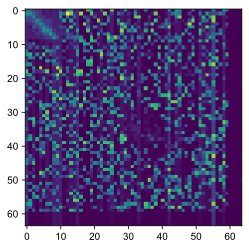

In [752]:
plt.imshow(g)

In [751]:
arr=2
test=0.1*np.ones([64,1])
g_final=dpe.read(arr, method='fast')
np_mult=np.dot(g_final.transpose(),test)
np_mult=g_final@test.transpose()
dpe_mult=dpe.multiply(arr, test, c_sel=[0,64], mode=0, Tdly=500, Vread=0.2)
result=np.append(np_mult,dpe_mult.transpose(),axis=1)

plt.plot(result[:,0]*1e6,result[:,1]*1e6,'bo')
plt.plot(result[:,0]*1e6,result[:,0]*1e6,'k')
plt.xlabel('Python result')
plt.ylabel('SuperT result')

ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 1 is different from 64)